### Objectives

This notebook creates a simple logistic regression model based on the transformed data from the EDA notebook. 

In [6]:
import sys
!{sys.executable} -m pip install plotly
!{sys.executable} -m pip install --upgrade --force-reinstall pandas --user
!{sys.executable} -m pip install dash --user
!{sys.executable} -m pip install -U imbalanced-learn

  Using cached https://files.pythonhosted.org/packages/74/8c/9cf2e5304f4466dbc759a799b97bfd75cd3dc93b00d49558ca93bfc29173/pandas-1.2.4-cp37-cp37m-win_amd64.whl
  Using cached https://files.pythonhosted.org/packages/d4/70/d60450c3dd48ef87586924207ae8907090de0b306af2bce5d134d78615cb/python_dateutil-2.8.1-py2.py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/70/94/784178ca5dd892a98f113cdd923372024dc04b8d40abe77ca76b5fb90ca6/pytz-2021.1-py2.py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/7d/3f/152a89cfdacbf747066268a93aae7d1911efc89abcbcf851f16d7881b85e/numpy-1.20.2-cp37-cp37m-win_amd64.whl
  Using cached https://files.pythonhosted.org/packages/ee/ff/48bde5c0f013094d729fe4b0316ba2a24774b3ff1c52d924a8a4cb04078a/six-1.15.0-py2.py3-none-any.whl
  Found existing installation: six 1.15.0
    Uninstalling six-1.15.0:
      Successfully uninstalled six-1.15.0
  Found existing installation: python-dateutil 2.8.1
    Uninstalling python-dateutil-2.8.1:


  The script f2py.exe is installed in 'C:\Users\galli\AppData\Roaming\Python\Python37\Scripts' which is not on PATH.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
Could not install packages due to an EnvironmentError: [WinError 5] Access is denied: 'C:\\Users\\galli\\AppData\\Local\\Temp\\pip-uninstall-j_y9e_fs\\users\\galli\\appdata\\roaming\\python\\python37\\site-packages\\numpy\\.libs\\libopenblas.gk7gx5keq4f6uyo3p26ulgbqyhgqo7j4.gfortran-win_amd64.dll'
Check the permissions.



Requirement already up-to-date: imbalanced-learn in c:\programdata\anaconda3\lib\site-packages (0.8.0)


In [9]:
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from imblearn.over_sampling import SMOTE
from sklearn.metrics import confusion_matrix

df = pd.read_csv('data/shots-2017-2020.csv')
df.rename(columns={"result.secondaryType": "shot_type", "team.triCode": "team"}, inplace=True)

#df['scored'] = df['event_type'].apply(lambda event: 1 if event == "GOAL" else 0)
#df['is_rebound_attempt'] = df['time_since_last_shot'].apply(lambda x: True if x <= 5 else False)
#df['shot_type'] = df['shot_type'].apply(lambda x: 'Wrist Shot' if pd.isna(x) else x)

df.loc[df.period <= 3, "total_time_remaining"] = (3 - df.loc[df.period <= 3]['period']) * 1200 + df.loc[df.period <= 3]['period_time_remaining']
df.loc[df.period > 3, "total_time_remaining"] = 0
df.head()

,game_id,season,result_event,period,x_coordinates,y_coordinates,team,shot_type,distance_to_goal,scored,time_of_last_shot,time_since_last_shot,period_time_remaining,is_rebound_attempt,total_time_remaining
0,2017020659,2017-2018,Shot,1,88.0,10.0,MIN,Wrap-around,10.0,0,132,49,1019,False,3419.0
1,2017020659,2017-2018,Missed Shot,1,34.0,-35.0,CGY,Wrist Shot,65.2,0,503,17,680,False,3080.0
2,2017020659,2017-2018,Shot,1,40.0,-18.0,MIN,Snap Shot,52.2,0,766,93,341,False,2741.0
3,2018020767,2018-2019,Blocked Shot,3,75.0,-9.0,COL,Wrist Shot,16.6,0,551,6,643,False,643.0
4,2018020773,2018-2019,Shot,1,54.0,-29.0,BOS,Wrist Shot,45.5,0,509,45,646,False,3046.0


In [10]:
scaler = MinMaxScaler()
scaler.fit(df[['period_time_remaining', 'distance_to_goal', 'x_coordinates', "y_coordinates", 'total_time_remaining', 'time_of_last_shot', 'time_since_last_shot']])
df[['period_time_remaining', 'distance_to_goal', 'x_coordinates', "y_coordinates", 'total_time_remaining', 'time_of_last_shot', 'time_since_last_shot']] = scaler.transform(df[['period_time_remaining', 'distance_to_goal', 'x_coordinates', "y_coordinates", 'total_time_remaining', 'time_of_last_shot', 'time_since_last_shot']])

cat_vars=['team', 'shot_type','is_rebound_attempt']
for var in cat_vars:
    cat_list='var'+'_'+var
    cat_list = pd.get_dummies(df[var], prefix=var)
    df1=df.join(cat_list)
    df=df1
cat_vars=['team', 'shot_type','is_rebound_attempt']
data_vars=df.columns.values.tolist()
to_keep=[i for i in data_vars if i not in cat_vars]

df = df[to_keep]
df = df[['period', 'period_time_remaining', 'x_coordinates',
       'y_coordinates', 'distance_to_goal',
       'time_of_last_shot', 'time_since_last_shot',
       'scored', 'total_time_remaining', 'team_ANA', 'team_ARI',
       'team_BOS', 'team_BUF', 'team_CAR', 'team_CBJ', 'team_CGY',
       'team_CHI', 'team_COL', 'team_DAL', 'team_DET', 'team_EDM',
       'team_FLA', 'team_LAK', 'team_MIN', 'team_MTL', 'team_NJD',
       'team_NSH', 'team_NYI', 'team_NYR', 'team_OTT', 'team_PHI',
       'team_PIT', 'team_SJS', 'team_STL', 'team_TBL', 'team_TOR',
       'team_VAN', 'team_VGK', 'team_WPG', 'team_WSH',
       'shot_type_Backhand', 'shot_type_Deflected', 'shot_type_Slap Shot',
       'shot_type_Snap Shot', 'shot_type_Tip-In', 'shot_type_Wrap-around',
       'shot_type_Wrist Shot', 'is_rebound_attempt_False',
       'is_rebound_attempt_True']]

df = df.dropna()
X_train, X_test, y_train, y_test = train_test_split(df.loc[:, df.columns != 'scored'], df[['scored']], test_size=0.33, random_state=42)
columns = X_train.columns

oversample = SMOTE(random_state=42)

X_train, y_train = oversample.fit_resample(X_train, y_train)

clf = DecisionTreeClassifier(max_depth=5)
clf.fit(X_train, y_train.values.ravel())
print("Predicting...")
pred = clf.predict(X_test)
print("scoring")
print(clf.score(X_test, y_test))

print(confusion_matrix(y_test, pred))
con_mat = confusion_matrix(y_test, pred)
print("Predictive Value:")
specificity = con_mat[1][1] / (con_mat[1][1] + con_mat[0][1])

Z_probs = clf.predict_proba(X_test)
X_test_final = X_test.copy()
X_test_final['scoreProb'] = [i[1] for i in Z_probs]

Predicting...
scoring
0.7960041669767096
[[123808  28905]
 [  3993   4562]]
Predictive Value:



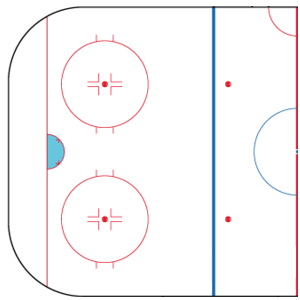

In [26]:
import plotly.graph_objects as go 
import base64
hockey_rink_rev_filepath = 'assets/Half_ice_hockey_rink_rev.png'
hockey_rink_rev = base64.b64encode(open(hockey_rink_rev_filepath, 'rb').read())
score_probs = go.Figure()
    
score_probs.add_trace(go.Histogram2dContour(
        x=X_test_final["x_coordinates"],
        y=X_test_final["y_coordinates"],
        z =X_test_final["scoreProb"]*specificity,
        colorscale = 'Thermal',
        xaxis = 'x',
        yaxis = 'y',
        opacity = .8,
        showscale = True,
        histfunc = "avg",
        name="Shot Distribution",
        hovertemplate = "x: %{x}<br>y: %{y}<br>Probability: %{z:.2%}"
        ))

score_probs.add_trace(go.Bar(
        y = X_test_final.groupby('y_coordinates').agg({'scoreProb': 'mean'}).reset_index()['y_coordinates'],
        x = X_test_final.groupby('y_coordinates').agg({'scoreProb': 'mean'}).reset_index()["scoreProb"]*.15,
        xaxis = 'x2',
        orientation='h',
        marker = dict(
            color = 'rgba(0,0,0,1)'
        ),
        hovertemplate = "y: %{y}<br>Probability: %{x:.2%}",
        name="Y-Axis Score Histogram"
    ))

score_probs.add_trace(go.Histogram(
        x = X_test_final["x_coordinates"],
        y = X_test_final["scoreProb"]*specificity,
        histfunc = 'avg',
        yaxis = 'y2',
        nbinsx=100,
        marker = dict(
            color = 'rgba(0,0,0,1)'
        ),
        hovertemplate = "y: %{x}<br>Probability: %{y:.2%}",
        name="X-Axis Score Histogram"
    ))

score_probs.update_layout(
    autosize = False,
    xaxis = dict(
        zeroline = False,
        domain = [0.15,1],
        showticklabels=False,
        fixedrange = True,
        showgrid = False
    ),
    yaxis = dict(
        zeroline = False,
        domain = [0,.85],
        showticklabels=False,
        fixedrange = True,
        showgrid = False
    ),
    xaxis2 = dict(
        zeroline = False,
        domain = [0,.15],
        fixedrange = True,
        showgrid = False
    ),
    yaxis2 = dict(
        zeroline = False,
        domain = [0.85,1],
        fixedrange = True,
        showgrid = False
    ),
    height = 600,
    width = 600,
    bargap = 0,
    hovermode = 'closest',
    showlegend = False,
    title={
        'text': "NHL Predicted Scoring Probabilities",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'}
)
score_probs['layout']['xaxis2']['autorange'] = "reversed"
score_probs['layout']['xaxis']['autorange'] = "reversed"
score_probs.add_layout_image(
            dict(
                source='data:image/png;base64,{}'.format(hockey_rink_rev.decode()),
                xref="x",
                yref="y",
                x=1.03,
                y=1.05,
                sizex=1.1,
                sizey=1.1,
                sizing="stretch",
                layer="below")
    )

score_probs.show()

In [74]:
X_test_final.head()

,period,period_time_remaining,coordinates.x,coordinates.y,distance_to_goal,time_of_last_shot,time_since_last_shot,total_time_remaining,team_ANA,team_ARI,...,shot_type_Backhand,shot_type_Deflected,shot_type_Slap Shot,shot_type_Snap Shot,shot_type_Tip-In,shot_type_Wrap-around,shot_type_Wrist Shot,is_rebound_attempt_False,is_rebound_attempt_True,scoreProb
33681,2,0.566667,0.679487,0.500000,0.300167,0.618333,0.187311,0.522222,0,0,...,0,0,0,0,1,0,0,1,0,0.763604
98668,1,0.448333,0.564103,0.607143,0.412368,0.495000,0.169184,0.816111,0,0,...,0,0,0,0,0,0,1,1,0,0.456324
96339,1,0.385833,0.679487,0.559524,0.301474,0.389167,0.012085,0.795278,0,0,...,0,0,0,0,0,0,1,0,1,0.456324
117766,3,0.141667,0.692308,0.321429,0.299958,0.148333,0.024169,0.047222,0,0,...,0,0,1,0,0,0,0,1,0,0.586116
75969,3,0.738333,0.756410,0.547619,0.228865,0.751667,0.048338,0.246111,0,0,...,0,0,0,0,0,0,1,1,0,0.456324
